# Install Required Libraries

In [1]:
!pip install numpy_indexed

In [2]:
!pip install hmmlearn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.4/160.4 kB 12.4 MB/s eta 0:00:00


# Import LIbraries

## Base Libraries

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import numpy_indexed as npi
import tensorflow as tf

## Hidden Markov Model Library

In [4]:
from hmmlearn import hmm

## CNN Feature Extraction Libraries

In [5]:
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dropout, Dense, Flatten
from keras.optimizers import Adam
from keras.models import Model
from keras.callbacks import TensorBoard
from datetime import datetime
from tensorflow import keras
from keras import backend as K

# Load And Check Data

## Load Data

In [6]:
DATASET = tf.keras.datasets.fashion_mnist
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.fashion_mnist.load_data()

4422102/4422102 [==============================] - 0s 0us/step


In [7]:
# Map each label to an integer
label_dictionary = {
    0 : "T-shirt/top",
    1 : "Trouser",
    2 : "Pullover",
    3 : "Dress",
    4 : "Coat",
    5 : "Sandal",
    6 : "Shirt",
    7 : "Sneaker",
    8 : "Bag",
    9 : "Ankle boot",
}

## Check Data

In [8]:
assert x_train.shape == (60000, 28, 28)
assert x_test.shape == (10000, 28, 28)
assert y_train.shape == (60000,)
assert y_test.shape == (10000,)

In [9]:
max_value = np.max(x_train)
min_value = np.min(x_train)
print(f"Minimum Value in Original Train Data is {min_value}")
print(f"Maximum Value in Original Train Data is {max_value}")

Minimum Value in Original Train Data is 0
Maximum Value in Original Train Data is 255


In [10]:
max_value = np.max(x_test)
min_value = np.min(x_test)
print(f"Minimum Value in Modified Test Data is {min_value}")
print(f"Maximum Value in Modified Test Data is {max_value}")

Minimum Value in Modified Test Data is 0
Maximum Value in Modified Test Data is 255


### Random Set Of Train Image For Checking

In [11]:
def make_plot(rows, cols, images , labels):
  fig = plt.figure(figsize=(rows*2, cols*2))
  for i in range(len(images)):
    fig.add_subplot(rows, cols, i+1)
    plt.imshow(images[i],cmap='gray')
    plt.axis("off")
    plt.title(f'Label : {labels[i]}')
  plt.show()

In [12]:
sample_images = []
sample_labels = []
sample_index  = []
for i in range(25):
  index = np.random.randint(0,x_train.shape[0])
  sample_index.append(index)
  sample_images.append(x_train[index])
  sample_labels.append(label_dictionary[y_train[index]])

In [13]:
plot_rows = 5
plot_cols = 5

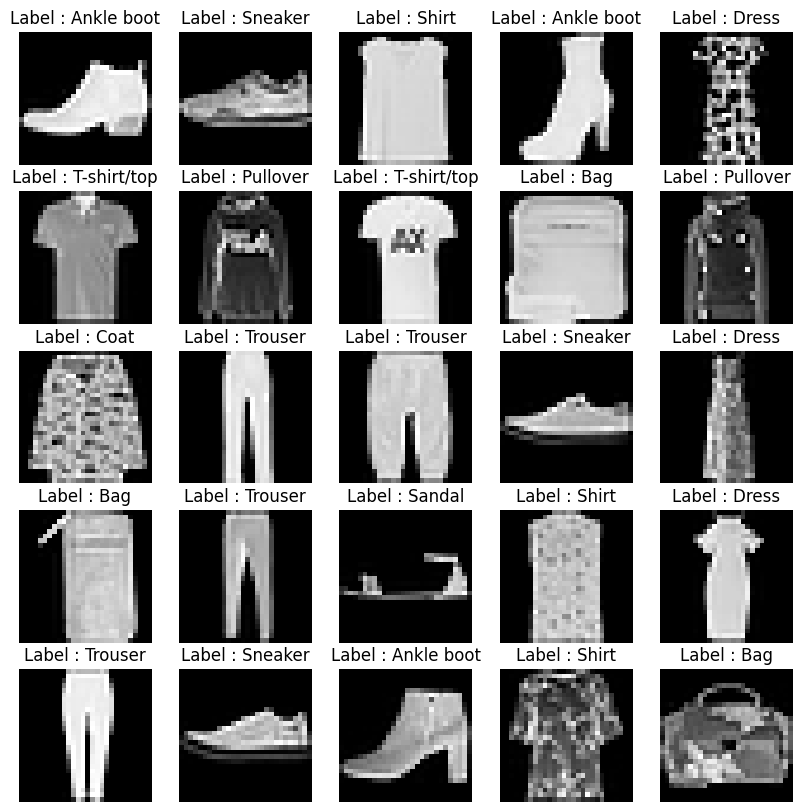

In [14]:
make_plot(plot_rows,plot_cols,sample_images , sample_labels)

# Only Use HMM

In [13]:
X_train, X_val, Y_train, Y_val = train_test_split(x_train, y_train, test_size=0.15, random_state=1234)

In [14]:
X_train = np.asarray(X_train)
X_val = np.asarray(X_val)
Y_train = np.asarray(Y_train)
Y_val = np.asarray(Y_val)

In [ ]:
HMM_train_input = X_train.reshape((X_train.shape[0], X_train.shape[1]*X_train.shape[2])).astype(int)
HMM_vali_input = X_val.reshape((X_val.shape[0], X_val.shape[1]*X_val.shape[2])).astype(int)

In [ ]:
HMM_splited_input = np.asarray(npi.group_by(Y_train).split(HMM_train_input))

<ipython-input-155-4de63876ae21>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  HMM_splited_input = np.asarray(npi.group_by(Y_train).split(HMM_train_input))


In [ ]:
HMM_splited_input.shape

(10,)

In [53]:
def HMM_Model(model, model_name, x_train, x_test, y_test, n_features, n_components=2, n_iter=5):
  HMM_List = []
  predict_List = np.zeros((x_test.shape[0] , x_train.shape[0]))
  for i in range(x_train.shape[0]):
    print(f"train Classifier : {i+1}")
    classifier = model(n_components=n_components, n_iter=n_iter)
    classifier.fit(x_train[i])
    HMM_List.append(classifier)
    for j in range(x_test.shape[0]):
      predict_List[j,i] = classifier.score(x_test[j].reshape(1,n_features))

  predict_label , predict_value = np.argmax(predict_List , axis=1) , np.max(predict_List , axis=1)
  accuracy = np.mean(predict_label == y_test)
  print(f"{model_name} Accuracy is {accuracy*100}%")
  return accuracy , HMM_List

In [ ]:
_ , categoricalHMM = HMM_Model(hmm.CategoricalHMM, "Categorical", HMM_splited_input, X_val, Y_val, 28*28)

train Classifier : 1
train Classifier : 2
train Classifier : 3
train Classifier : 4
train Classifier : 5
train Classifier : 6
train Classifier : 7
train Classifier : 8
train Classifier : 9
train Classifier : 10
Categorical Accuracy is 23.933333333333334%


In [ ]:
_ , poissonHMM = HMM_Model(hmm.PoissonHMM, "Poisson", HMM_splited_input, X_val, Y_val, 28*28)

train Classifier : 1
train Classifier : 2
train Classifier : 3
train Classifier : 4
train Classifier : 5
train Classifier : 6
train Classifier : 7
train Classifier : 8
train Classifier : 9
train Classifier : 10
Poisson Accuracy is 13.744444444444445%


In [ ]:
_ , gaussianHMM = HMM_Model(hmm.GaussianHMM, "Gaussian", HMM_splited_input, X_val, Y_val, 28*28)

train Classifier : 1
train Classifier : 2
train Classifier : 3
train Classifier : 4
train Classifier : 5
train Classifier : 6
train Classifier : 7
train Classifier : 8
train Classifier : 9
train Classifier : 10
Gaussian Accuracy is 45.077777777777776%


In [ ]:
_ , multinomialHMM = HMM_Model(hmm.MultinomialHMM, "Multinomial", HMM_splited_input, X_val, Y_val, 28*28)

https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 1


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 2


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 3


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 4


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 5


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 6


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 7


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 8


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 9


https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


train Classifier : 10
Multinomial Accuracy is 59.24444444444445%


# Extract Features From Images

## Create CNN

In [ ]:
%load_ext tensorboard

In [ ]:
!rm -rf ./logs/

In [ ]:
logdir = "logs/scalars/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [ ]:
cnn_model = Sequential()
cnn_model.add(Conv2D(filters=64, kernel_size=(3,3), input_shape=(28,28,1), activation='relu'))
cnn_model.add(MaxPooling2D(pool_size = (2,2)))
cnn_model.add(Dropout(rate=0.3))
cnn_model.add(Flatten())
cnn_model.add(Dense(units=32, activation='relu'))
cnn_model.add(Dense(units=10, activation='sigmoid'))
cnn_model.compile(optimizer=Adam(lr=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
cnn_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 26, 26, 64)        640       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 13, 13, 64)       0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 13, 13, 64)        0         
                                                                 
 flatten_1 (Flatten)         (None, 10816)             0         
                                                                 
 dense_2 (Dense)             (None, 32)                346144    
                                                                 
 dense_3 (Dense)             (None, 10)                330       
                                                      

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


## Train CNN

In [ ]:
history = cnn_model.fit(x=X_train, y=Y_train, batch_size=512, epochs=50, validation_data=(X_val, Y_val), callbacks=[tensorboard_callback])

Epoch 1/50
100/100 [==============================] - 55s 536ms/step - loss: 3.9498 - accuracy: 0.1701 - val_loss: 2.1521 - val_accuracy: 0.1844
Epoch 2/50
100/100 [==============================] - 55s 551ms/step - loss: 2.1441 - accuracy: 0.1802 - val_loss: 2.1104 - val_accuracy: 0.1873
Epoch 3/50
100/100 [==============================] - 55s 555ms/step - loss: 1.9857 - accuracy: 0.2529 - val_loss: 1.7756 - val_accuracy: 0.3359
Epoch 4/50
100/100 [==============================] - 52s 526ms/step - loss: 1.6620 - accuracy: 0.3837 - val_loss: 1.5080 - val_accuracy: 0.4384
Epoch 5/50
100/100 [==============================] - 55s 548ms/step - loss: 1.4212 - accuracy: 0.4732 - val_loss: 1.2788 - val_accuracy: 0.5289
Epoch 6/50
100/100 [==============================] - 54s 543ms/step - loss: 1.2385 - accuracy: 0.5308 - val_loss: 1.1310 - val_accuracy: 0.5774
Epoch 7/50
100/100 [==============================] - 53s 528ms/step - loss: 1.0391 - accuracy: 0.6124 - val_loss: 0.9037 - val_ac

In [ ]:
eval_result = cnn_model.evaluate(x_test, y_test)
print("Accuracy : {:.3f}".format(eval_result[1]))

313/313 [==============================] - 3s 9ms/step - loss: 0.3305 - accuracy: 0.9010
Accuracy : 0.901


In [ ]:
cnn_model.save('my_model')

In [ ]:
%tensorboard --logdir logs/scalars

<IPython.core.display.Javascript object>

In [ ]:
!zip -r my_model.zip my_model/

  adding: my_model/ (stored 0%)
  adding: my_model/variables/ (stored 0%)
  adding: my_model/variables/variables.data-00000-of-00001 (deflated 9%)
  adding: my_model/variables/variables.index (deflated 62%)
  adding: my_model/assets/ (stored 0%)
  adding: my_model/saved_model.pb (deflated 88%)
  adding: my_model/keras_metadata.pb (deflated 88%)
  adding: my_model/fingerprint.pb (stored 0%)


## Get Output Of Relu Layer as Input Representation

In [ ]:
cnn_model.layers

In [ ]:
cnn_model.layers[4].output

<KerasTensor: shape=(None, 32) dtype=float32 (created by layer 'dense_2')>

In [ ]:
relu_layer = Model(inputs=cnn_model.input, outputs=cnn_model.layers[4].output)

## Extract Features From Train And Test Data

In [ ]:
train_features = relu_layer.predict(x_train).astype(int)
test_features = relu_layer.predict(x_test).astype(int)

313/313 [==============================] - 4s 11ms/step


In [ ]:
splited_train = npi.group_by(y_train).split(train_features)

In [ ]:
splited_train.shape

(10, 6000, 32)

In [ ]:
def distribution_plot(data):
  rows = 4
  cols = 8
  fig = plt.figure(figsize=(rows*5, cols*5))
  for i in range(rows*cols):
    fig.add_subplot(rows, cols, i+1)
    plt.hist(data[:,i])
    plt.title(f'Feature : {i}')
  plt.show()

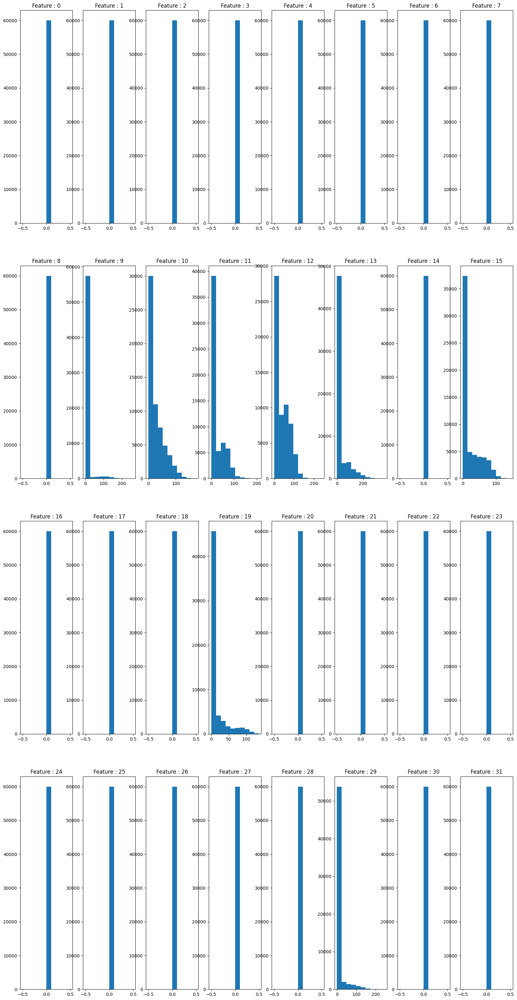

In [ ]:
distribution_plot(train_features)

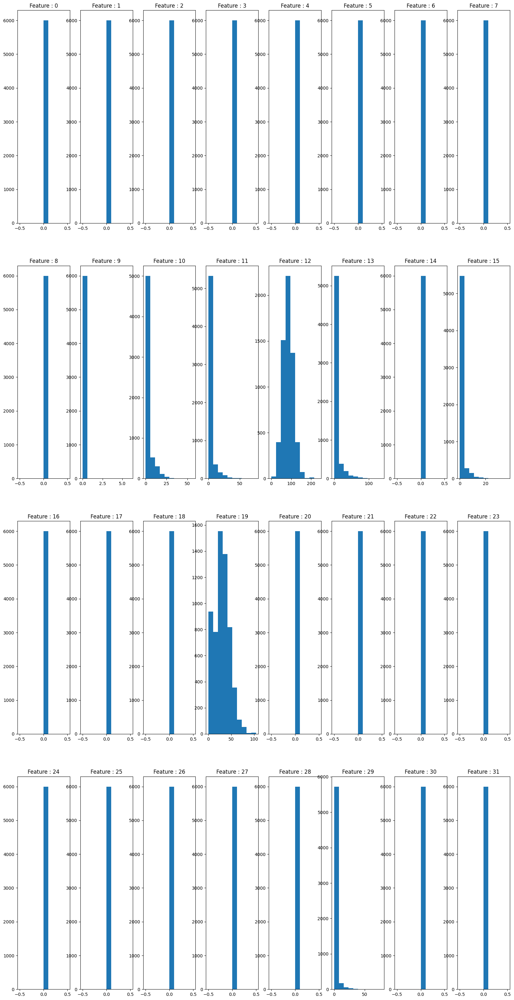

In [ ]:
distribution_plot(splited_train[0])

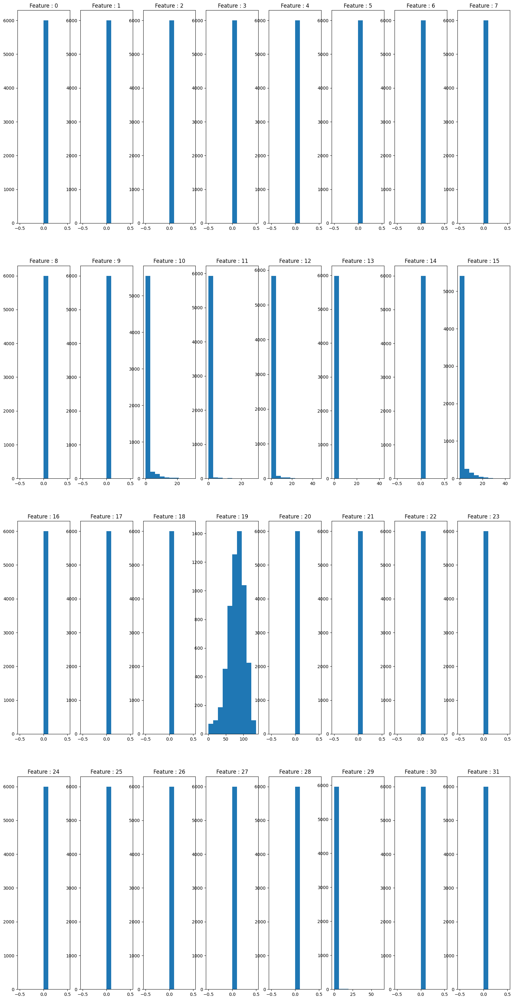

In [ ]:
distribution_plot(splited_train[1])

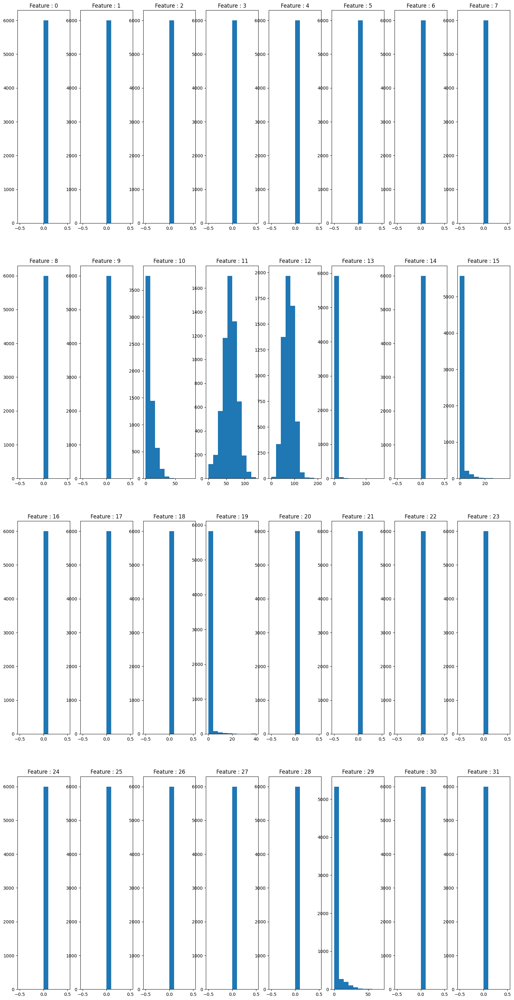

In [ ]:
distribution_plot(splited_train[2])

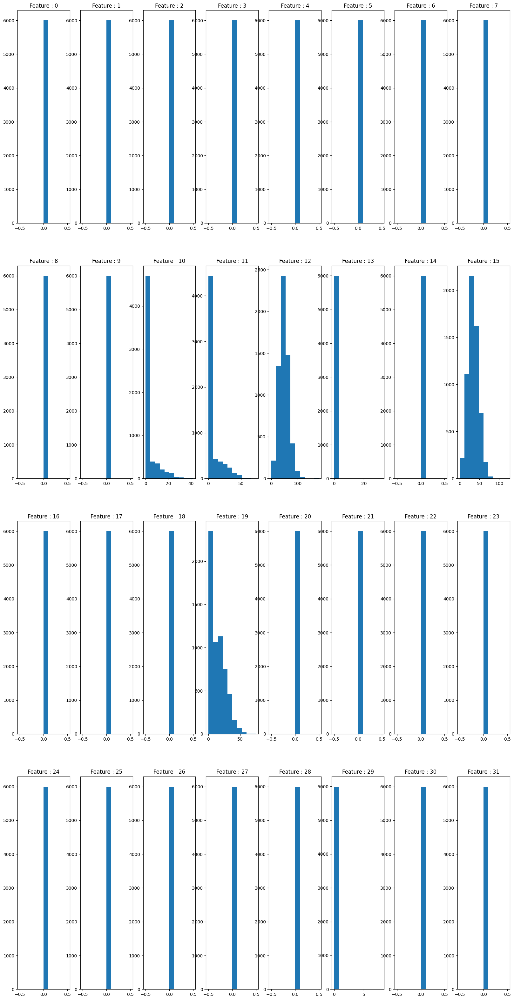

In [ ]:
distribution_plot(splited_train[3])

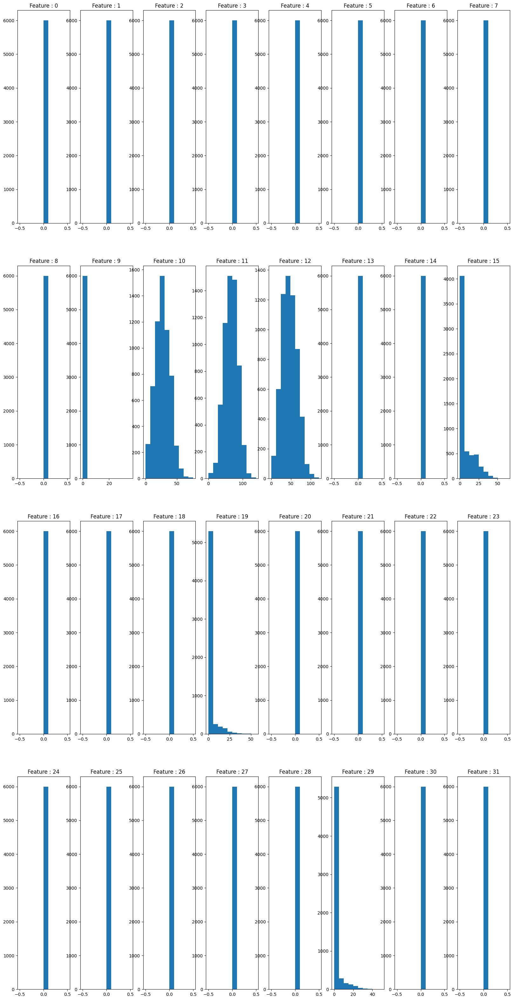

In [ ]:
distribution_plot(splited_train[4])

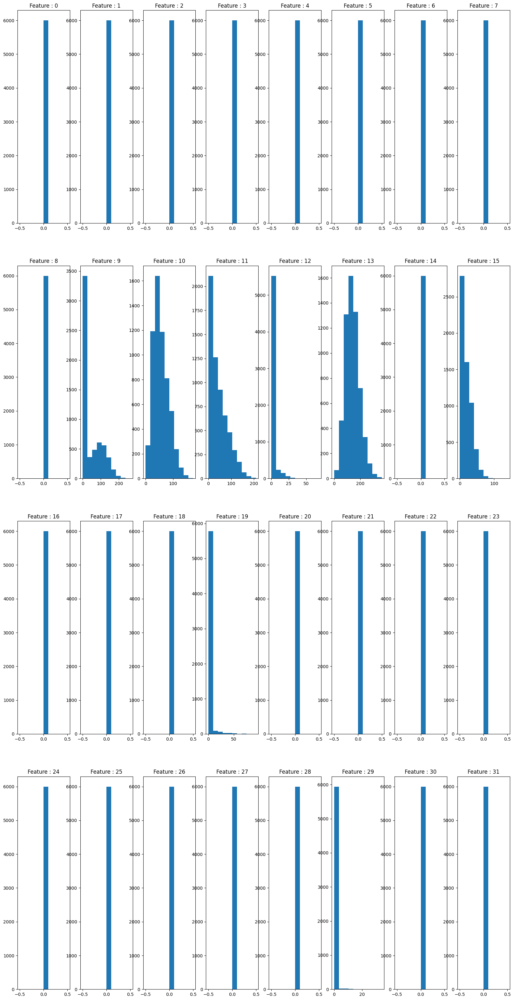

In [ ]:
distribution_plot(splited_train[5])

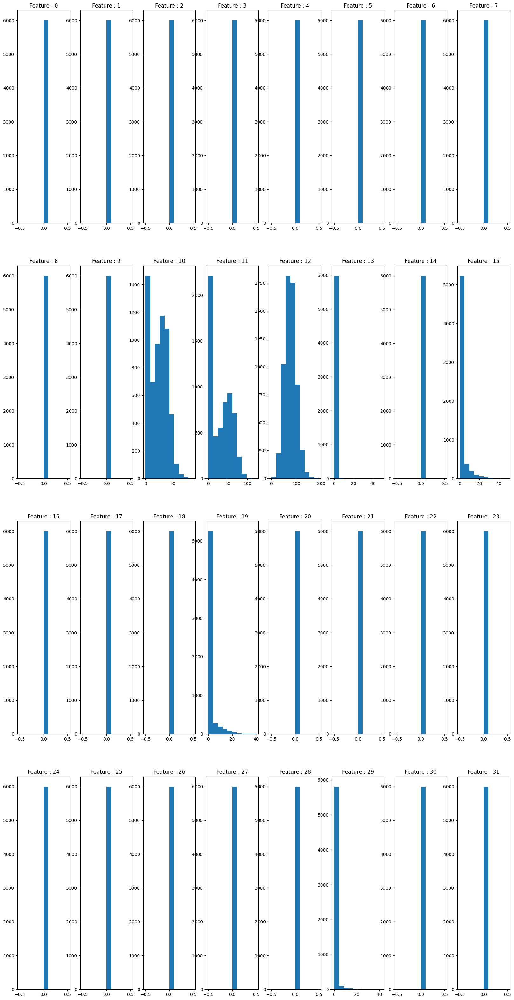

In [ ]:
distribution_plot(splited_train[6])

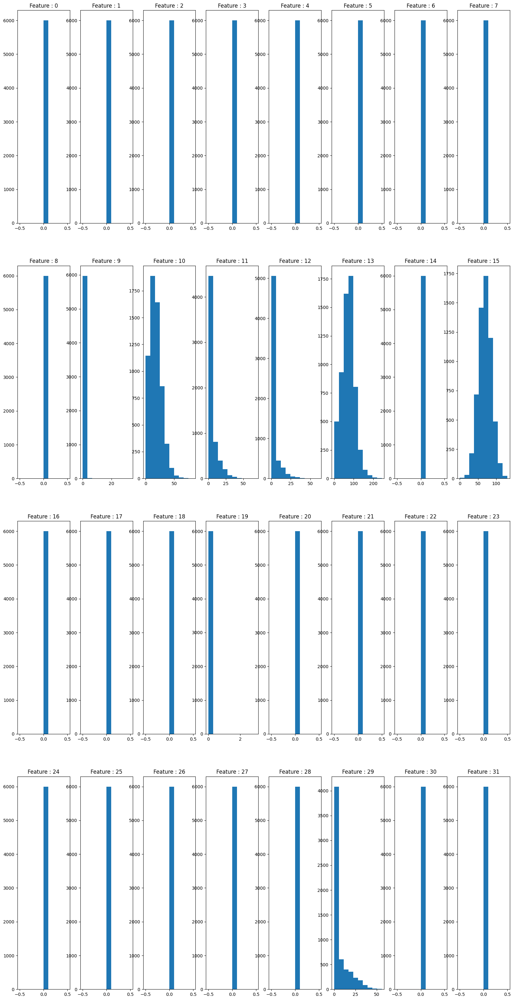

In [ ]:
distribution_plot(splited_train[7])

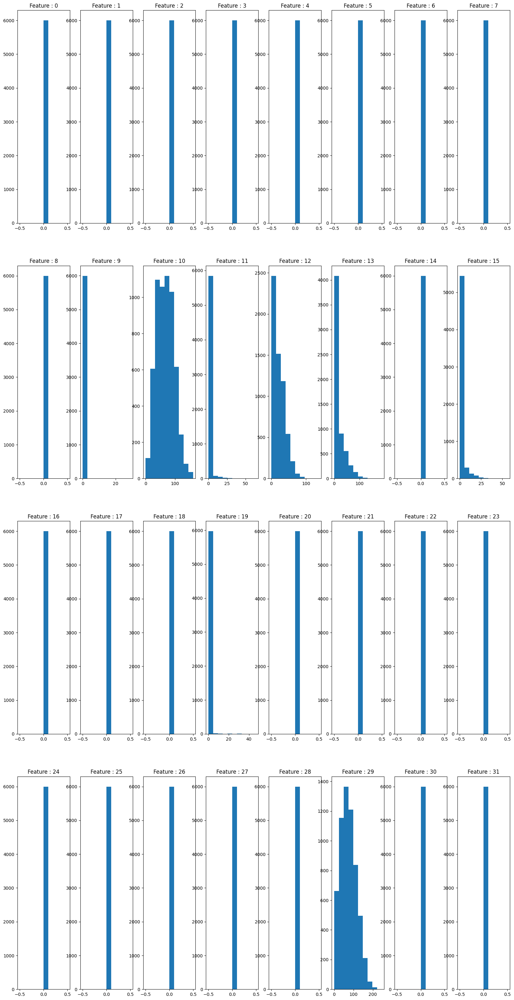

In [ ]:
distribution_plot(splited_train[8])

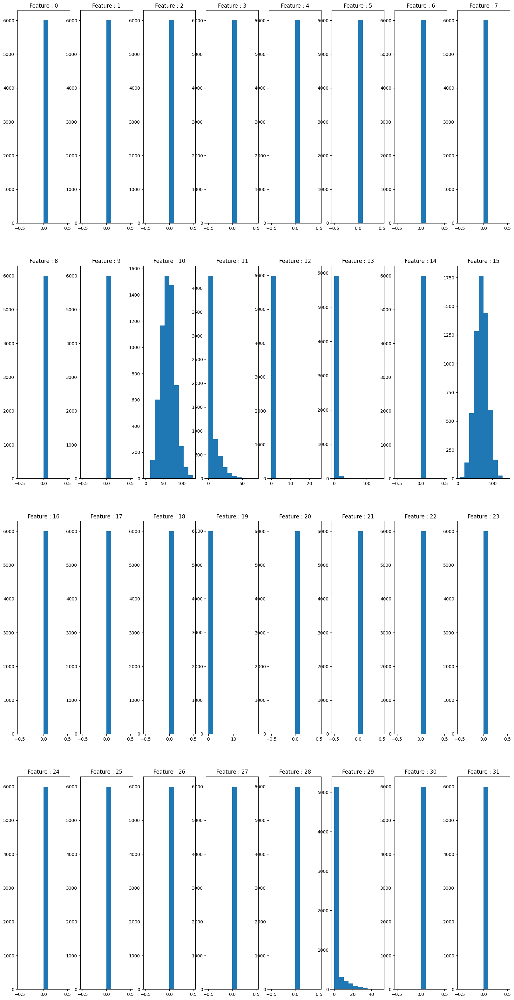

In [ ]:
distribution_plot(splited_train[9])

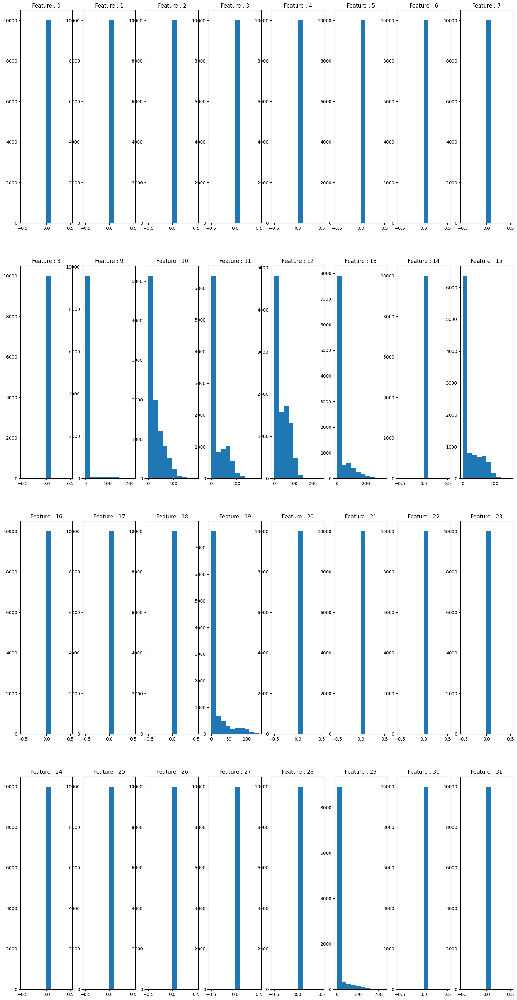

In [ ]:
distribution_plot(test_features)

In [ ]:
acc , final_hmm = HMM_Model(hmm.PoissonHMM, "CNN + HMM", splited_train, test_features, y_test, 32)

train Classifier : 1
train Classifier : 2
train Classifier : 3
train Classifier : 4
train Classifier : 5
train Classifier : 6
train Classifier : 7
train Classifier : 8
train Classifier : 9
train Classifier : 10
CNN + HMM Accuracy is 85.2%


In [16]:
%load_ext tensorboard

In [17]:
!rm -rf ./logs/

In [18]:
logdir = "logs/scalars/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback_2 = keras.callbacks.TensorBoard(log_dir=logdir)

In [19]:
cnn_model_2 = Sequential()
cnn_model_2.add(Conv2D(filters=64, kernel_size=(3,3), input_shape=(28,28,1), activation='relu'))
cnn_model_2.add(MaxPooling2D(pool_size = (2,2)))
cnn_model_2.add(Dropout(rate=0.3))
cnn_model_2.add(Flatten())
cnn_model_2.add(Dense(units=64, activation='relu'))
cnn_model_2.add(Dense(units=10, activation='sigmoid'))
cnn_model_2.compile(optimizer=Adam(lr=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
cnn_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 13, 13, 64)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 13, 13, 64)        0         
                                                                 
 flatten (Flatten)           (None, 10816)             0         
                                                                 
 dense (Dense)               (None, 64)                692288    
                                                                 
 dense_1 (Dense)             (None, 10)                650       
                                                        

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


# Change Base CNN Model

In [20]:
history_2 = cnn_model_2.fit(x=X_train, y=Y_train, batch_size=512, epochs=50, validation_data=(X_val, Y_val), callbacks=[tensorboard_callback_2])

Epoch 1/50
100/100 [==============================] - 34s 330ms/step - loss: 4.8818 - accuracy: 0.5660 - val_loss: 1.0239 - val_accuracy: 0.6794
Epoch 2/50
100/100 [==============================] - 33s 330ms/step - loss: 0.8974 - accuracy: 0.7309 - val_loss: 0.7906 - val_accuracy: 0.7658
Epoch 3/50
100/100 [==============================] - 34s 344ms/step - loss: 0.7489 - accuracy: 0.7715 - val_loss: 0.6964 - val_accuracy: 0.7797
Epoch 4/50
100/100 [==============================] - 34s 337ms/step - loss: 0.5706 - accuracy: 0.8148 - val_loss: 0.4709 - val_accuracy: 0.8433
Epoch 5/50
100/100 [==============================] - 34s 339ms/step - loss: 0.4169 - accuracy: 0.8645 - val_loss: 0.4015 - val_accuracy: 0.8707
Epoch 6/50
100/100 [==============================] - 34s 344ms/step - loss: 0.3670 - accuracy: 0.8777 - val_loss: 0.3726 - val_accuracy: 0.8779
Epoch 7/50
100/100 [==============================] - 34s 342ms/step - loss: 0.3300 - accuracy: 0.8881 - val_loss: 0.3476 - val_ac

In [21]:
eval_result_2 = cnn_model_2.evaluate(x_test, y_test)
print("Accuracy : {:.3f}".format(eval_result_2[1]))

313/313 [==============================] - 2s 7ms/step - loss: 0.3534 - accuracy: 0.9082
Accuracy : 0.908


In [22]:
cnn_model_2.save('my_model_2')

In [23]:
%tensorboard --logdir logs/scalars

<IPython.core.display.Javascript object>

In [24]:
!zip -r my_model2.zip my_model_2/

  adding: my_model_2/ (stored 0%)
  adding: my_model_2/variables/ (stored 0%)
  adding: my_model_2/variables/variables.data-00000-of-00001 (deflated 8%)
  adding: my_model_2/variables/variables.index (deflated 62%)
  adding: my_model_2/assets/ (stored 0%)
  adding: my_model_2/saved_model.pb (deflated 87%)
  adding: my_model_2/keras_metadata.pb (deflated 88%)
  adding: my_model_2/fingerprint.pb (stored 0%)


In [25]:
cnn_model_2.layers

In [26]:
relu_layer_2 = Model(inputs=cnn_model_2.input, outputs=cnn_model_2.layers[4].output)

In [27]:
train_features_2 = relu_layer_2.predict(x_train).astype(int)
test_features_2 = relu_layer_2.predict(x_test).astype(int)

313/313 [==============================] - 2s 6ms/step


In [28]:
splited_train = npi.group_by(y_train).split(train_features_2)

In [31]:
def distribution_plot_2(data):
  rows = 8
  cols = 6
  fig = plt.figure(figsize=(rows*5, cols*5))
  for i in range(rows*cols):
    fig.add_subplot(rows, cols, i+1)
    plt.hist(data[:,i])
    plt.title(f'Feature : {i}')
  plt.show()

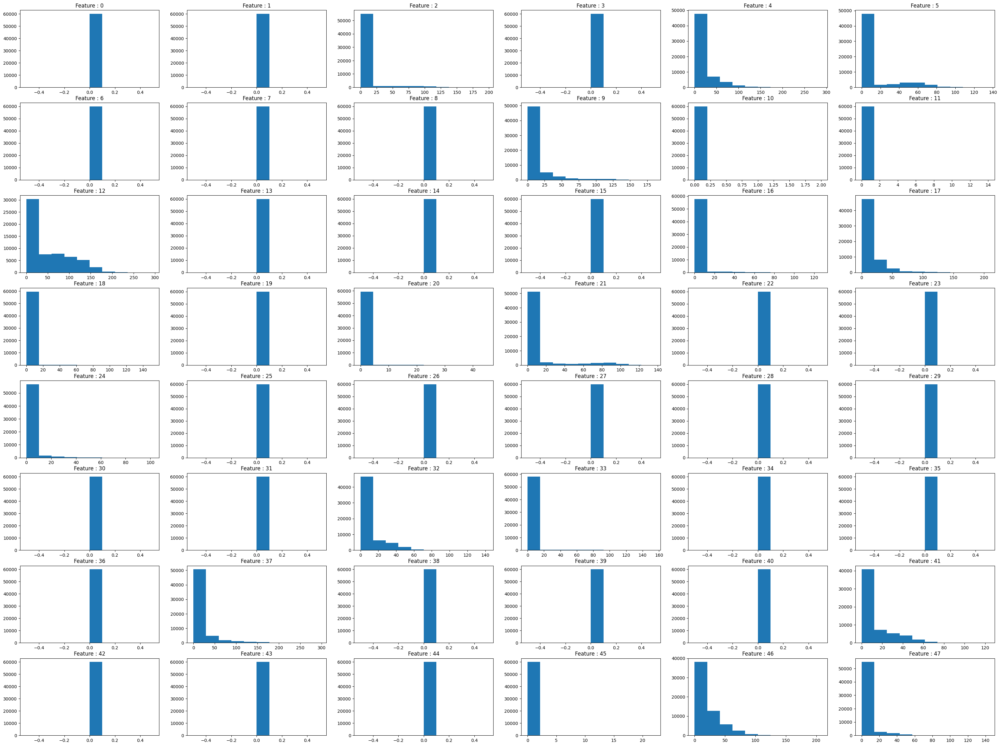

In [32]:
distribution_plot_2(train_features_2)

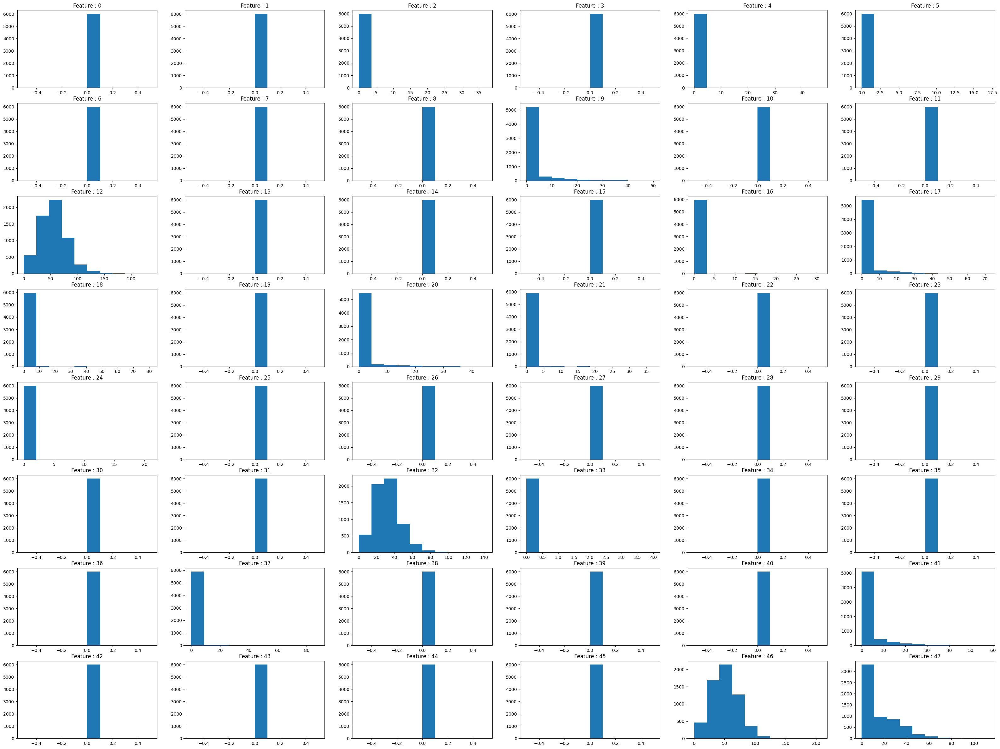

In [33]:
distribution_plot_2(splited_train[0])

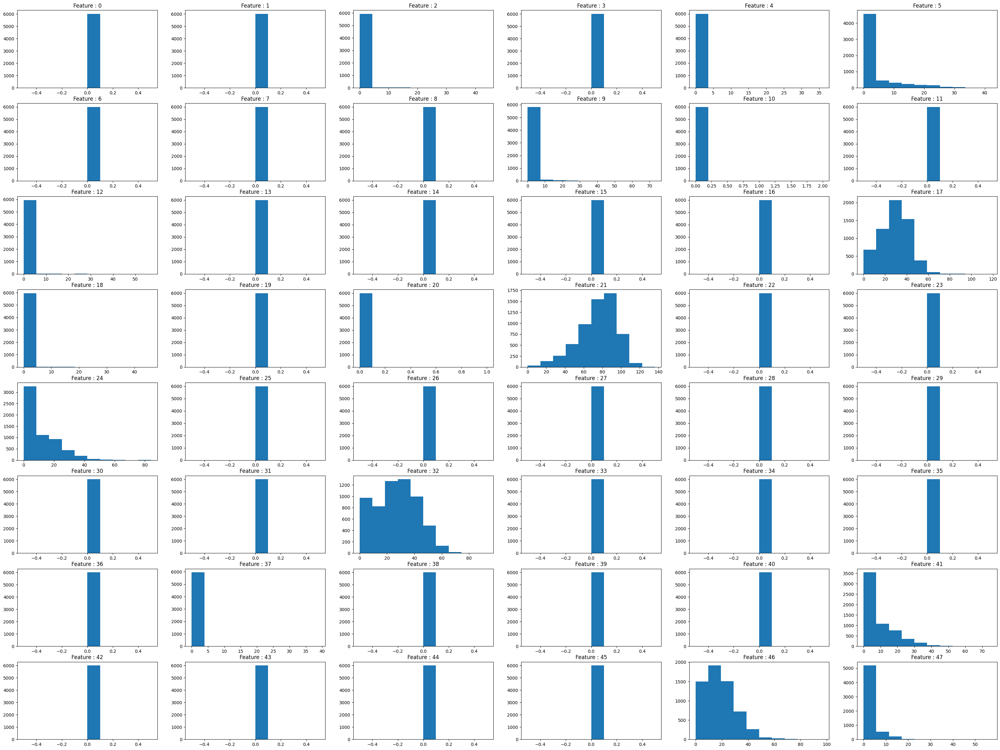

In [34]:
distribution_plot_2(splited_train[1])

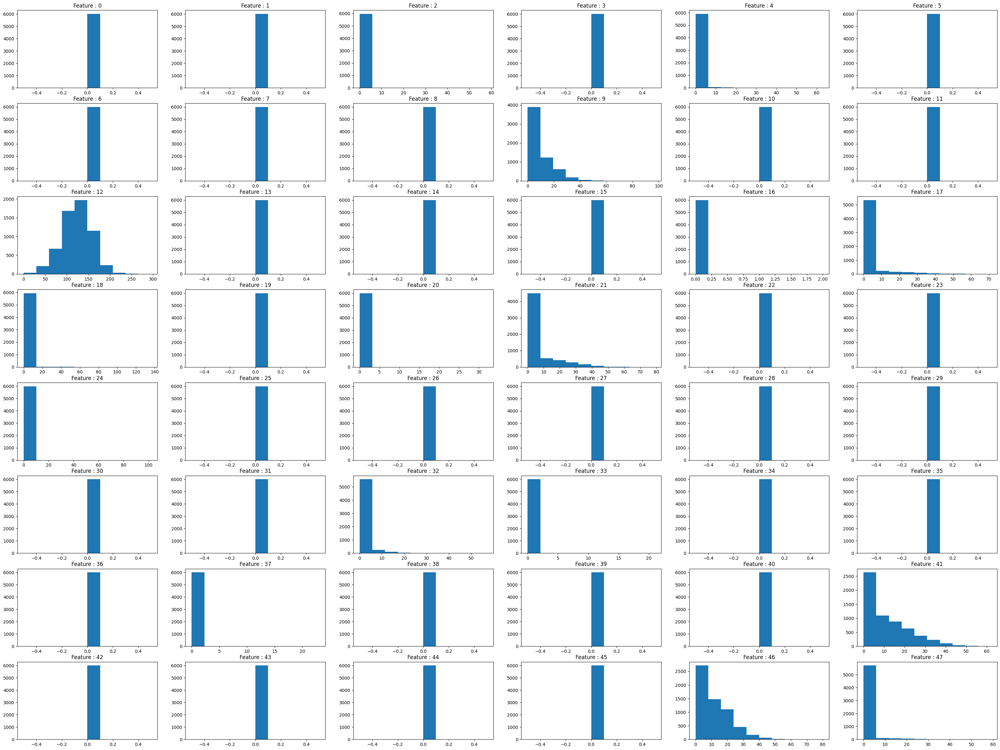

In [35]:
distribution_plot_2(splited_train[2])

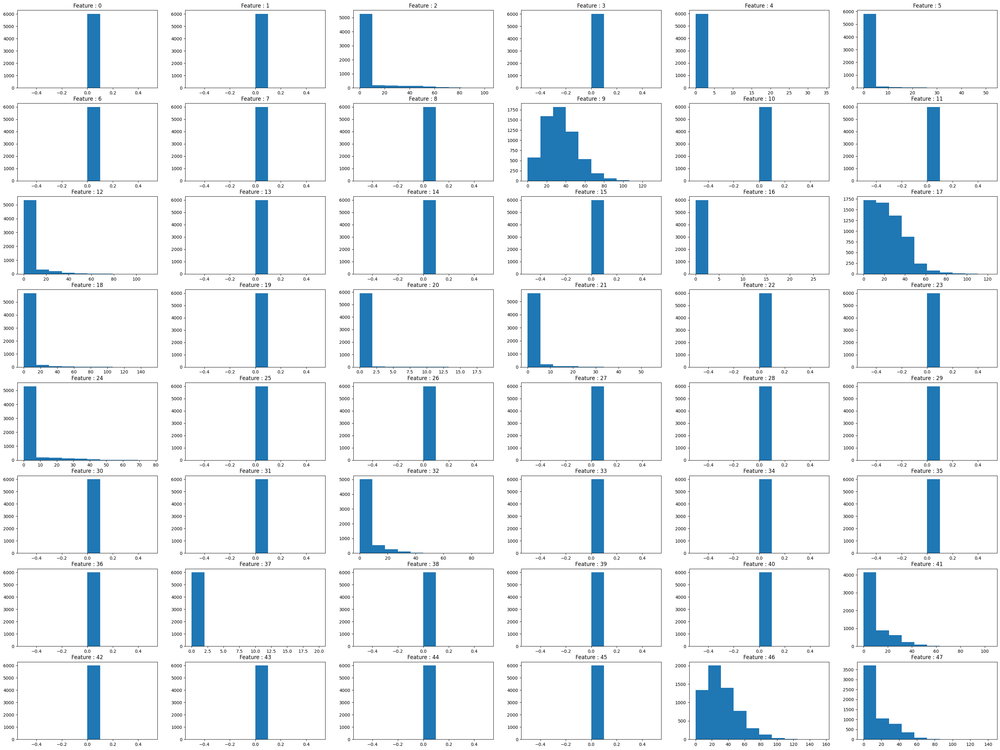

In [36]:
distribution_plot_2(splited_train[3])

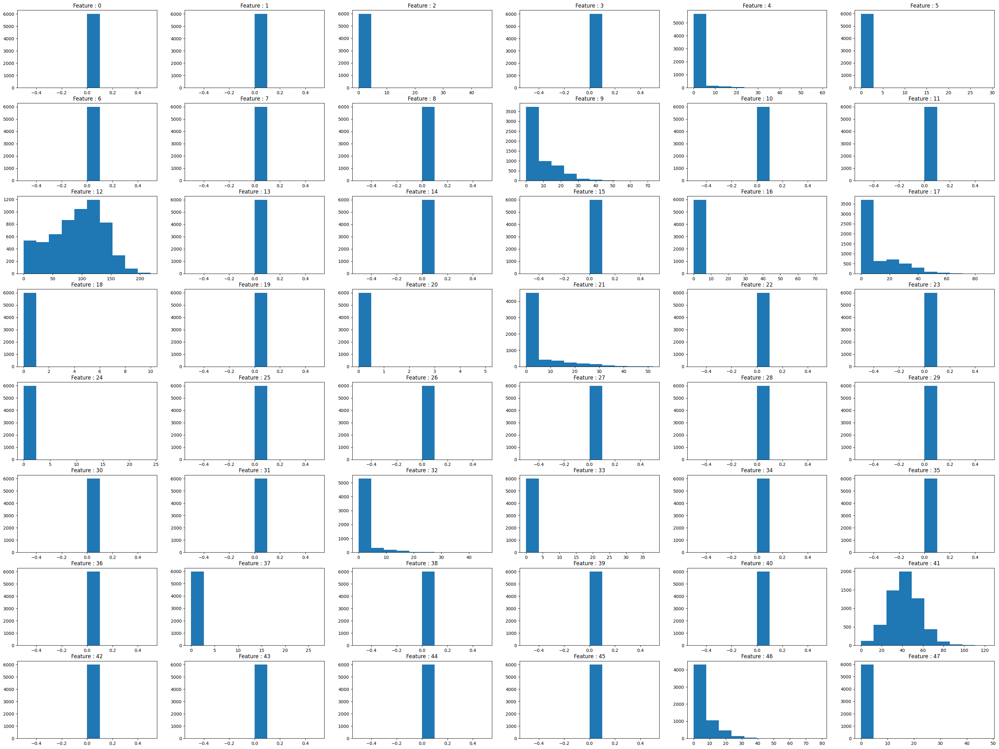

In [37]:
distribution_plot_2(splited_train[4])

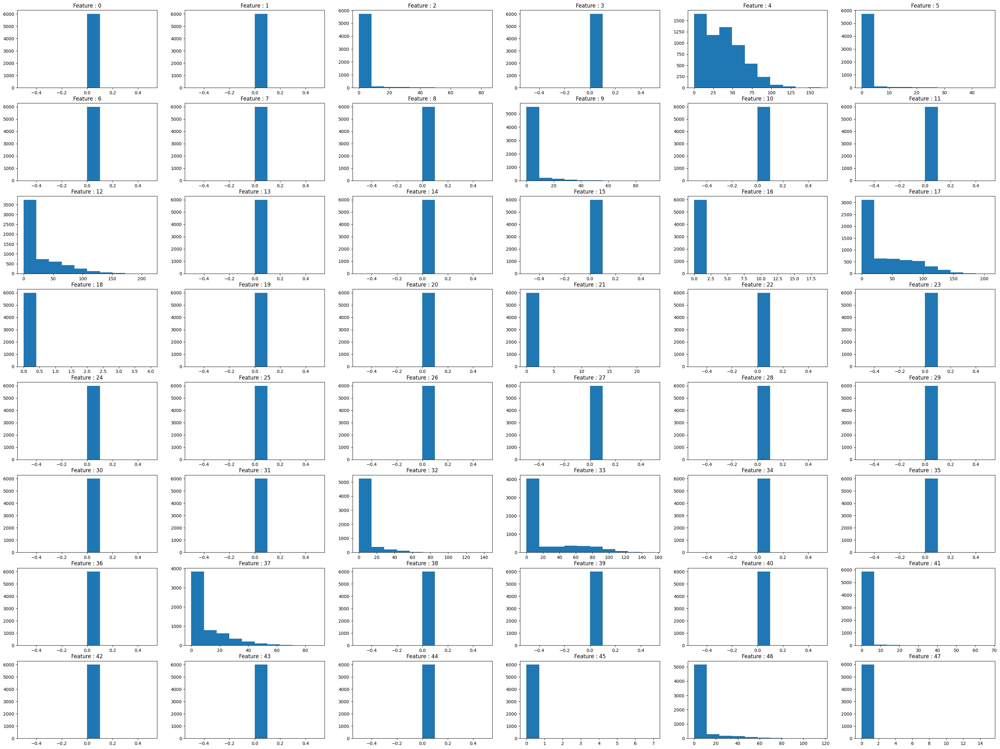

In [38]:
distribution_plot_2(splited_train[5])

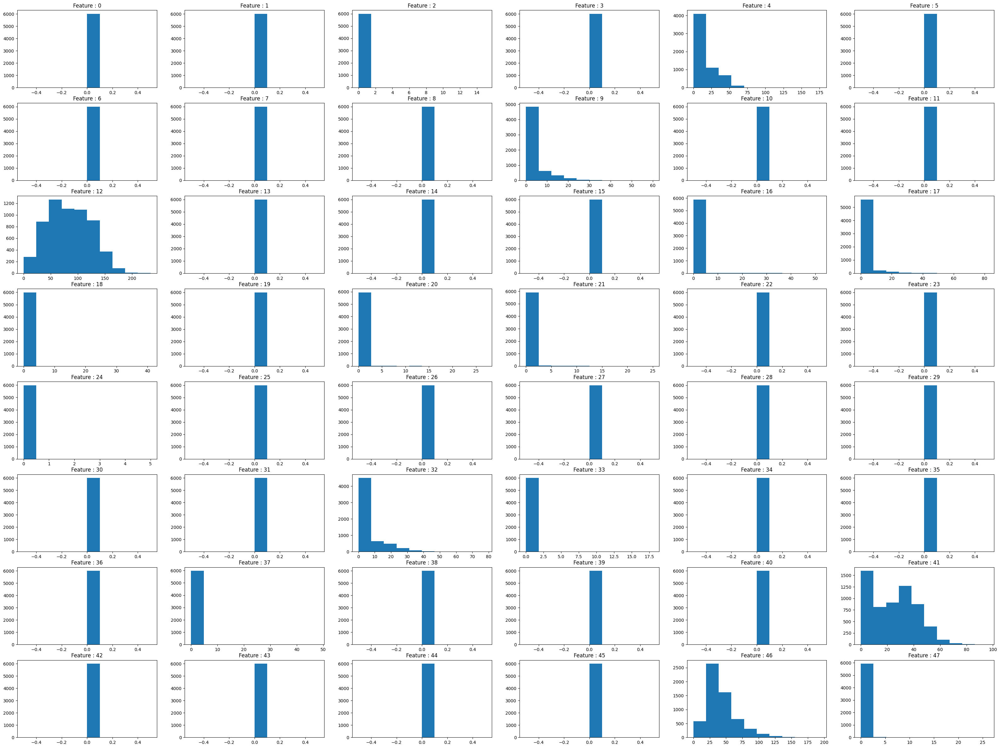

In [39]:
distribution_plot_2(splited_train[6])

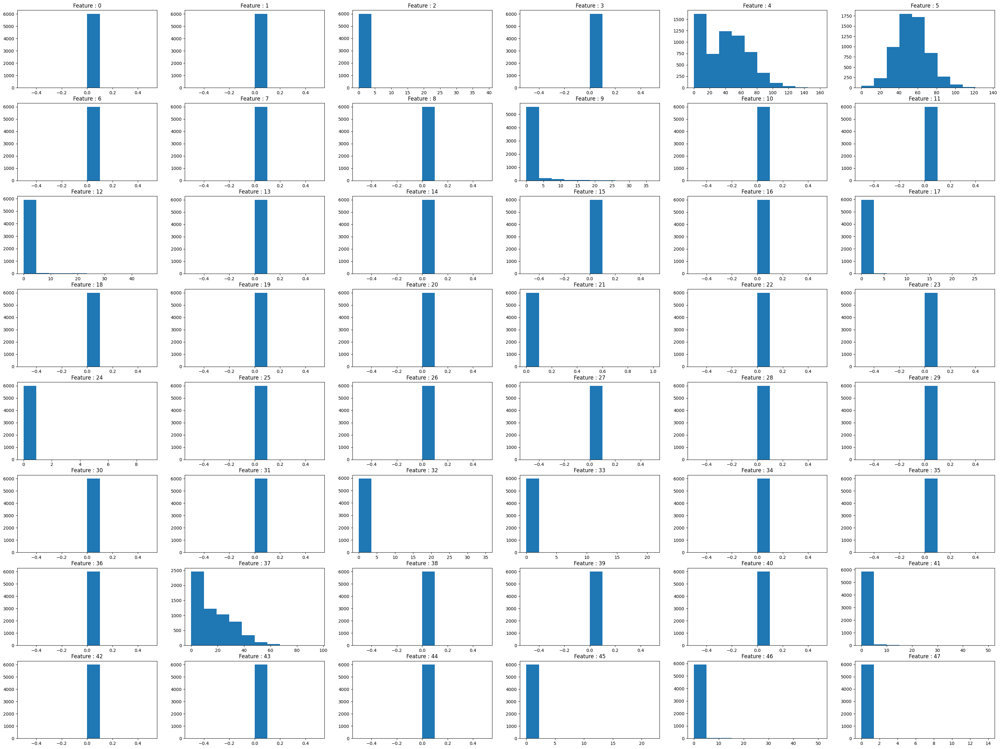

In [40]:
distribution_plot_2(splited_train[7])

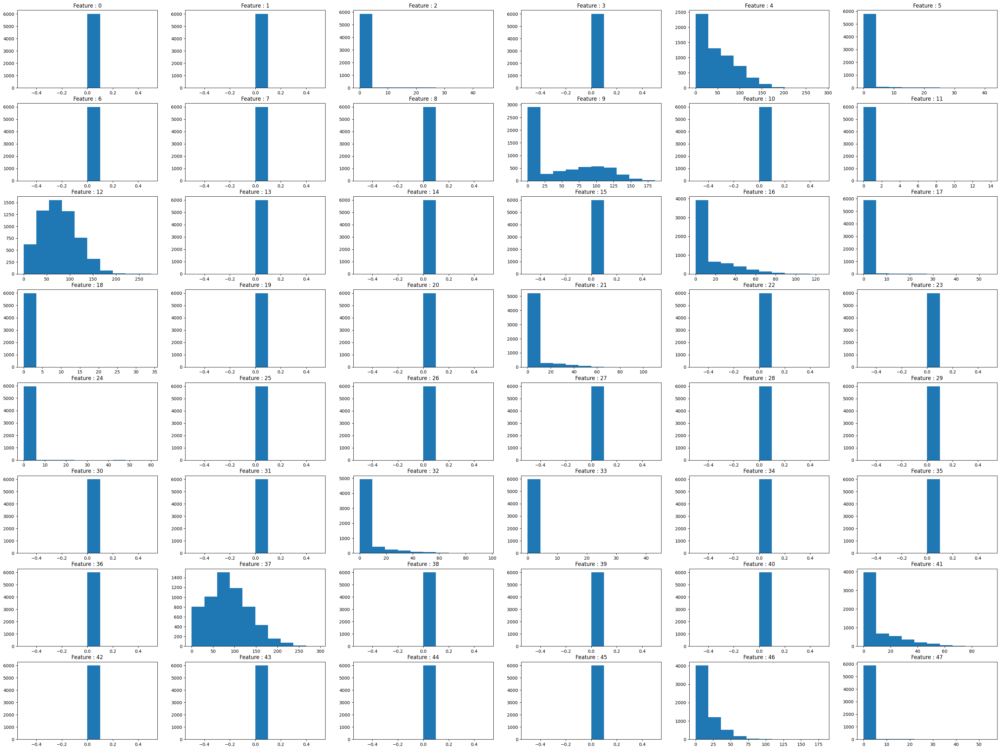

In [41]:
distribution_plot_2(splited_train[8])

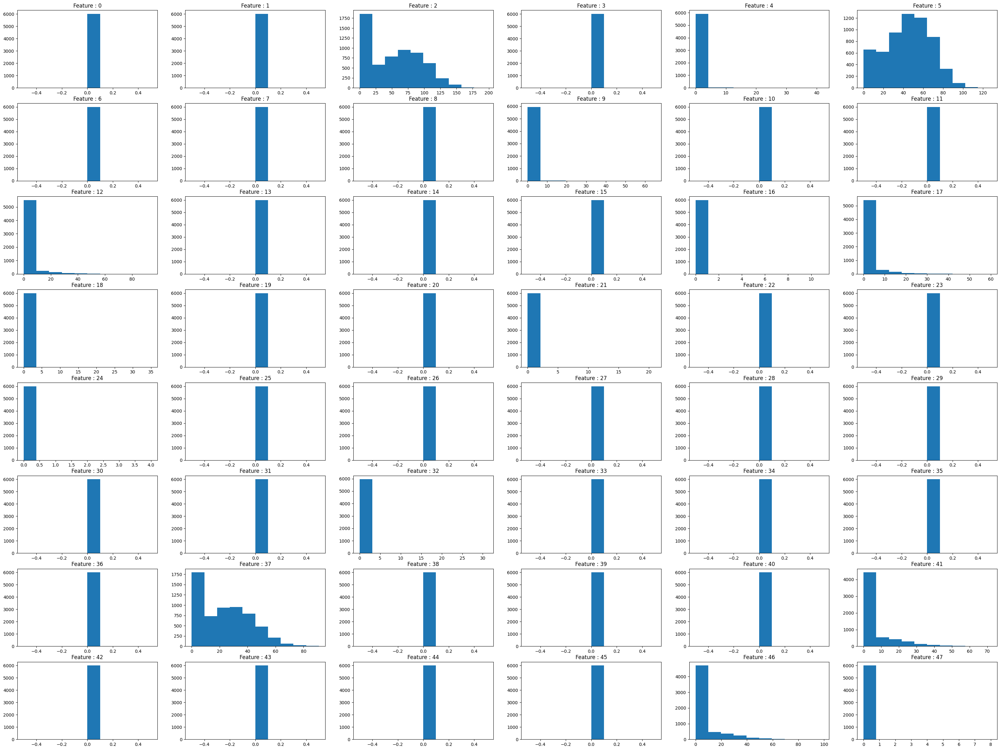

In [42]:
distribution_plot_2(splited_train[9])

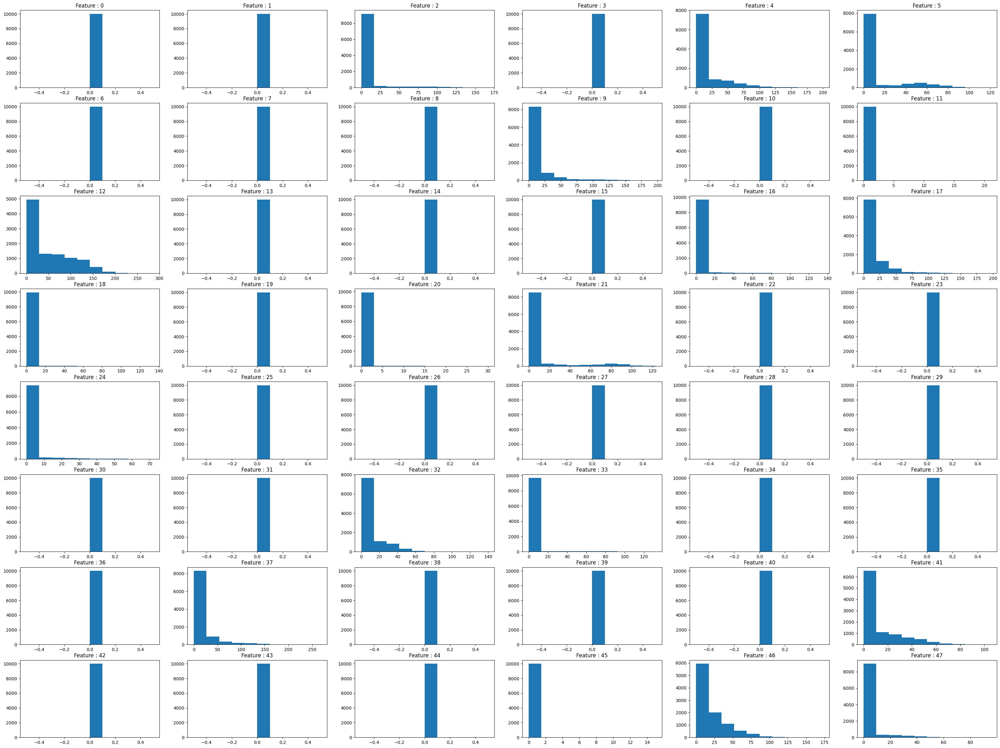

In [43]:
distribution_plot_2(test_features_2)

In [58]:
acc , final_hmm_2 = HMM_Model(hmm.PoissonHMM, "CNN + HMM", splited_train, test_features_2, y_test, 64)

train Classifier : 1
train Classifier : 2
train Classifier : 3
train Classifier : 4
train Classifier : 5
train Classifier : 6
train Classifier : 7
train Classifier : 8
train Classifier : 9
train Classifier : 10
CNN + HMM Accuracy is 86.86%


# Other Scores

In [ ]:
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.utils.np_utils import to_categorical

In [60]:
predict_List = np.zeros((x_test.shape[0] , 10))
for i in range(10):
    classifier = final_hmm_2[i]
    for j in range(x_test.shape[0]):
      predict_List[j,i] = classifier.score(test_features_2[j].reshape(1,64))

predict_label , predict_value = np.argmax(predict_List , axis=1) , np.max(predict_List , axis=1)

In [61]:
splited_res = npi.group_by(y_test).split(predict_label)

In [69]:
conf_matrix = confusion_matrix(y_test, predict_label)

In [71]:
for i in conf_matrix:
    print('\t'.join(map(str, i)))

900	2	13	41	4	4	29	0	7	0
2	977	0	15	3	0	1	0	2	0
28	0	781	9	149	0	32	0	1	0
19	12	4	932	15	1	15	0	0	2
2	0	43	79	812	0	64	0	0	0
0	0	0	0	0	938	0	46	0	16
240	0	89	42	49	0	571	0	9	0
0	0	0	0	0	1	0	992	0	7
3	1	2	9	13	63	33	8	868	0
0	0	0	0	0	5	1	79	0	915


In [70]:
f1_score(y_test, predict_label , average='macro')

0.8663712165805231

In [83]:
roc_auc_score(to_categorical(y_test), predict_value.reshape((y_test.shape[0], 1)), multi_class='ovr')

0.6815393333333333